In [8]:
import numpy as np
import pandas as pd
import geopandas as gpd
import os
import imageio

from shapely.geometry import Point, box
from sklearn.metrics import accuracy_score, matthews_corrcoef, confusion_matrix, r2_score
import higra as hg
import scipy.ndimage as si
from skimage import measure
import pickle
import shutil
from copy import deepcopy

import matplotlib.pyplot as plt
%matplotlib inline

# Stitch predictions and compute instances

## Load val/test splits

In [4]:
splits_path = '../data/splits/india_planetImagery_splits_20x20_v2.csv'
splits_df = pd.read_csv(splits_path)
splits_df['image_id'] = splits_df['image_id'].astype(str).str.zfill(4)
fold = 'test' # 'val'
image_ids = splits_df[splits_df['fold'] == fold]['image_id'].values

## Stitch predictions

In [5]:
# IMAGES
# 2x downsampled
# img_dir = '../data/general_blockchain/airbus_false_color/large/2x_downsample/'
# original resolution
img_dir = '../data/general_blockchain/airbus_false_color/large/original/'

# RESULTS
# trained on 1x Planet in France
# results_dir = '../results/india/GeneralBlockchain/fractal-resunet_3month-separate_nfilter-32_depth-6_bs-8_lr-0.001_1x-downsampled_allfields_n6759/Airbus_original/'
# results_dir = '../results/india/GeneralBlockchain/fractal-resunet_3month-separate_nfilter-32_depth-6_bs-7_lr-0.001_1x-downsampled_allfields_n6759_1250px_thickness2/Airbus_original/'
results_dirs = ['../results/india/GeneralBlockchain/full-france_fractal-resunet_3month-separate_nfilter-32_depth-6_bs-7_lr-0.001_1x-downsampled_allfields_n6759_1250px_thickness2/Airbus_original/']
# trained on 1x-3x downsampled together
# results_dir = '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_2x_downsampled/'
# results_dir = '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_original/'
# trained on 2x downsampled only
# results_dir = '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_2x-downsampled-erosion1px_finetuned/Airbus_2x_downsampled/'
# trained on original resolution only
# results_dir = '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_original-resolution_finetuned/Airbus_original/'
# results_dirs = ['../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.0001_original_finetuned2-continued/Airbus_original/']
# results_dir = '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.0003_original-resolution_fromscratch-continued2/Airbus_original/'

# DATASET SIZE EXPERIMENTS
# results_dirs = [ '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.001_original-resolution_n1000_fromscratch/Airbus_original/',
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.0001_original-resolution_n1000_finetuned/Airbus_original/',
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.001_original-resolution_n400_fromscratch/Airbus_original/',
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.0001_original-resolution_n400_finetuned/Airbus_original/',
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.001_original-resolution_n200_fromscratch/Airbus_original/',
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.0001_original-resolution_n200_finetuned/Airbus_original/',
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.001_original-resolution_n100_fromscratch/Airbus_original/',
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.0001_original-resolution_n100_finetuned/Airbus_original/',
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.001_original-resolution_n40_fromscratch-continued/Airbus_original/',
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.0001_original-resolution_n40_finetuned-continued/Airbus_original/'
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.001_original-resolution_n20_fromscratch-continued/Airbus_original/',
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.0001_original-resolution_n20_finetuned-continued/Airbus_original/'
# ]

for results_dir in results_dirs:
    print(results_dir)
    
    extent_dir = os.path.join(results_dir, 'extent_predictions/')
    boundary_dir = os.path.join(results_dir, 'boundary_predictions/')
    extent_save = os.path.join(results_dir, 'extent_full')
    boundary_save = os.path.join(results_dir, 'boundary_full')
    if not os.path.exists(os.path.join(extent_save)):
        os.makedirs(os.path.join(extent_save))
    if not os.path.exists(os.path.join(boundary_save)):
        os.makedirs(os.path.join(boundary_save))

    for image_id in image_ids:
        pred_names = [x for x in os.listdir(extent_dir) if '_C{}_x'.format(image_id) in x]

        orig_img = imageio.imread(os.path.join(img_dir, 'airbus_geowiki_C{}.png'.format(image_id)))
        extent_pred = np.zeros((orig_img.shape[0], orig_img.shape[1]))
        extent_count = np.zeros((orig_img.shape[0], orig_img.shape[1]))
        boundary_pred = np.zeros((orig_img.shape[0], orig_img.shape[1]))
        boundary_count = np.zeros((orig_img.shape[0], orig_img.shape[1]))

        for pred_name in pred_names:
            x = int(pred_name.split('_')[3][1:])
            y = int(pred_name.split('_')[4][1:-4])

            extent_tile = imageio.imread(os.path.join(extent_dir, pred_name))
            # extent_tile = cv2.resize(extent_tile, (768, 768))
            extent_pred[x:x+extent_tile.shape[0], y:y+extent_tile.shape[1]] += extent_tile
            extent_count[x:x+extent_tile.shape[0], y:y+extent_tile.shape[1]] += 1

            boundary_tile = imageio.imread(os.path.join(boundary_dir, pred_name))
            # boundary_tile = cv2.resize(boundary_tile, (768, 768))
            boundary_pred[x:x+boundary_tile.shape[0], y:y+boundary_tile.shape[1]] += boundary_tile
            boundary_count[x:x+boundary_tile.shape[0], y:y+boundary_tile.shape[1]] += 1

        extent_full = np.array(extent_pred/extent_count, dtype=np.uint8)
        boundary_full = np.array(boundary_pred/boundary_count, dtype=np.uint8)

        imageio.imwrite(os.path.join(extent_save, 'airbus_geowiki_C{}.png'.format(image_id)), extent_full)
        imageio.imwrite(os.path.join(boundary_save, 'airbus_geowiki_C{}.png'.format(image_id)), boundary_full)

../results/india/GeneralBlockchain/full-france_fractal-resunet_3month-separate_nfilter-32_depth-6_bs-7_lr-0.001_1x-downsampled_allfields_n6759_1250px_thickness2/Airbus_original/


/home/swang222/anaconda3/envs/geopython/lib/python3.7/site-packages/ipykernel/__main__.py:72: RuntimeWarning: divide by zero encountered in true_divide
/home/swang222/anaconda3/envs/geopython/lib/python3.7/site-packages/ipykernel/__main__.py:72: RuntimeWarning: invalid value encountered in true_divide
/home/swang222/anaconda3/envs/geopython/lib/python3.7/site-packages/ipykernel/__main__.py:73: RuntimeWarning: divide by zero encountered in true_divide
/home/swang222/anaconda3/envs/geopython/lib/python3.7/site-packages/ipykernel/__main__.py:73: RuntimeWarning: invalid value encountered in true_divide


In [9]:
# remove tile predictions
results_dirs = [
    '../results/india/GeneralBlockchain/full-france_fractal-resunet_3month-separate_nfilter-32_depth-6_bs-7_lr-0.001_1x-downsampled_allfields_n6759_1250px_thickness2/Airbus_original/'
#     '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.0001_original_finetuned2-continued/Airbus_original/'
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.001_original-resolution_n1000_fromscratch/Airbus_original/',
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.0001_original-resolution_n1000_finetuned/Airbus_original/',
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.001_original-resolution_n400_fromscratch/Airbus_original/',
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.0001_original-resolution_n400_finetuned/Airbus_original/',
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.001_original-resolution_n200_fromscratch/Airbus_original/',
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.0001_original-resolution_n200_finetuned/Airbus_original/',
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.001_original-resolution_n100_fromscratch/Airbus_original/',
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.0001_original-resolution_n100_finetuned/Airbus_original/',
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.001_original-resolution_n40_fromscratch-continued/Airbus_original/',
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.0001_original-resolution_n40_finetuned-continued/Airbus_original/'
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.001_original-resolution_n20_fromscratch-continued/Airbus_original/',
#                 '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-8_lr-0.0001_original-resolution_n20_finetuned-continued/Airbus_original/'
]

for results_dir in results_dirs:
    extent_pred_dir = os.path.join(results_dir, 'extent_predictions')
    boundary_pred_dir = os.path.join(results_dir, 'boundary_predictions')
    if os.path.exists(extent_pred_dir):
        shutil.rmtree(extent_pred_dir)
    if os.path.exists(boundary_pred_dir):
        shutil.rmtree(boundary_pred_dir)

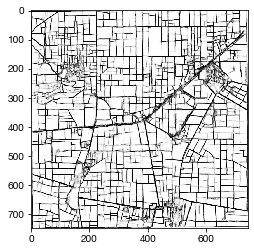

In [10]:
plt.imshow(extent_full, cmap='Greys_r')
plt.show()

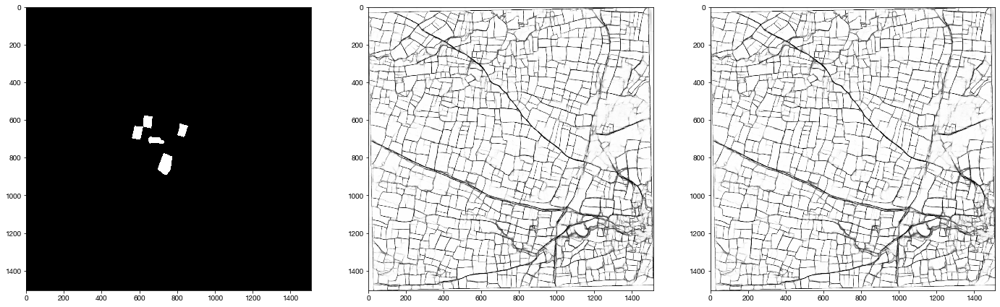

In [22]:
label = imageio.imread('../data/general_blockchain/airbus_labels/large/original/airbus_geowiki_C0001.png')
extent_full1 = imageio.imread('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.0001_original_finetuned2-continued/Airbus_original/extent_full/airbus_geowiki_C0001.png')
extent_full2 = imageio.imread('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.0001_original_finetuned2-continued/Airbus_original/extent_full/airbus_geowiki_C0001.png')

fig, ax = plt.subplots(1, 3, figsize=(24, 8))
ax[0].imshow(label, cmap='Greys_r')
ax[1].imshow(extent_full1, cmap='Greys_r')
ax[2].imshow(extent_full2, cmap='Greys_r')
plt.show()

## Watershed segmentation

In [3]:
def InstSegm(extent, boundary, t_ext=0.4, t_bound=0.2):
    """
    INPUTS:
    extent : extent prediction
    boundary : boundary prediction
    t_ext : threshold for extent
    t_bound : threshold for boundary
    OUTPUT:
    instances
    """

    # Threshold extent mask
    ext_binary = np.uint8(extent >= t_ext)

    # Artificially create strong boundaries for
    # pixels with non-field labels
    input_hws = np.copy(boundary)
    input_hws[ext_binary == 0] = 1

    # Create the directed graph
    size = input_hws.shape[:2]
    graph = hg.get_8_adjacency_graph(size)
    edge_weights = hg.weight_graph(
        graph,
        input_hws,
        hg.WeightFunction.mean
    )

    tree, altitudes = hg.watershed_hierarchy_by_dynamics(
        graph,
        edge_weights
    )
    
    # Get individual fields
    # by cutting the graph using altitude
    instances = hg.labelisation_horizontal_cut_from_threshold(
        tree,
        altitudes,
        threshold=t_bound)
    
    instances[ext_binary == 0] = -1

    return instances

### Hyperparameter tuning

In [4]:
splits_path = '../data/splits/india_planetImagery_splits_20x20_v2.csv'
splits_df = pd.read_csv(splits_path, dtype=str)
splits_df['image_id'] = splits_df['image_id'].str.zfill(4)
train_ids = sorted(splits_df[splits_df['fold'] == 'train']['image_id'].values)
val_ids = sorted(splits_df[splits_df['fold'] == 'val']['image_id'].values)
test_ids = sorted(splits_df[splits_df['fold'] == 'test']['image_id'].values)

In [5]:
def get_IoUs(extent_true, extent_pred, boundary_pred, t_ext=0.4, 
             t_bound=0.2, plot=False):
    
    # get predicted instance segmentation
    instances_pred = InstSegm(extent_pred, boundary_pred, t_ext=t_ext, t_bound=t_bound)
    instances_pred = measure.label(instances_pred, background=-1)
    
    # get instances from ground truth label
    binary_true = extent_true > 0
    instances_true = measure.label(binary_true, background=0, connectivity=1)
    
    if plot:
        fig, ax = plt.subplots(1, 2, figsize=(8, 4))
        ax[0].imshow(instances_true)
        ax[1].imshow(instances_pred)
        plt.show()
    
    # loop through true fields
    field_values = np.unique(instances_true)
    best_IoUs = []
    field_sizes = []
    
    for field_value in field_values:
        if field_value == 0:
            continue # move on to next value
            
        this_field = instances_true == field_value
        field_sizes.append(np.sum(this_field))
        
        # find predicted fields that intersect with true field
        intersecting_fields = this_field * instances_pred
        intersect_values = np.unique(intersecting_fields)
        
        intersect_fields = np.isin(instances_pred, intersect_values[1:])
        
        if plot:
            fig, ax = plt.subplots(1, 2, figsize=(8, 4))
            ax[0].imshow(this_field)
            ax[1].imshow(intersect_fields)
            plt.show()
        
        # compute IoU for each intersecting field
        field_IoUs = []
        for intersect_value in intersect_values:
            if intersect_value == 0:
                continue # move on to next value
            pred_field = instances_pred == intersect_value
            union = this_field + pred_field > 0
            intersection = (this_field * pred_field) > 0
            IoU = np.sum(intersection) / np.sum(union)
            field_IoUs.append(IoU)
    
        # take maximum IoU - this is the IoU for this true field
        if len(field_IoUs) > 0:
            best_IoUs.append(np.max(field_IoUs))
        else:
            best_IoUs.append(0)
    
    return best_IoUs, field_sizes

In [ ]:
# hyperparameter values
t_exts = np.linspace(0.0, 0.5, 6)
t_bounds = np.linspace(0.0, 0.5, 6)

# run for all test fields
image_ids = val_ids

# Airbus
# label_dir = '../data/general_blockchain/airbus_labels/large/3x_downsample_erosion2px_val/'
label_dir = '../data/general_blockchain/airbus_labels/large/2x_downsample_erosion1px/'
# label_dir = '../data/general_blockchain/airbus_labels/large/original/'
model_names = ['fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned']
# model_names = ['fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_2x-downsampled-erosion1px_finetuned/']
# model_names = ['fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_original-resolution_finetuned/']
# model_name = 'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_fromscratch/'

for model_name in model_names:
    print(model_name)
    # results_dir = '../results/india/GeneralBlockchain/{}/Airbus_3x_downsampled/'.format(model_name)
    results_dir = '../results/india/GeneralBlockchain/{}/Airbus_2x_downsampled/'.format(model_name)
    # results_dir = '../results/india/GeneralBlockchain/{}/Airbus_original/'.format(model_name)
    mIoUs = []
    IoU_50s = []
    for t_ext in t_exts:
        for t_bound in t_bounds:
            IoUs = []

            for i, image_id in enumerate(image_ids):
                if i % 100 == 0:
                    print(i)
                label_path = os.path.join(label_dir, 'airbus_geowiki_C{}.png'.format(image_id))
                if os.path.exists(label_path):
                    example_truth = imageio.imread(label_path)
                    # extent = np.load(os.path.join(results_dir, 'extent_predictions/airbus_geowiki_C{}.npy'.format(image_id)))
                    # boundary = np.load(os.path.join(results_dir, 'boundary_predictions/airbus_geowiki_C{}.npy'.format(image_id)))
                    extent_pred = imageio.imread(os.path.join(results_dir, 'extent_full/airbus_geowiki_C{}.png'.format(image_id)))
                    extent_pred = np.array(extent_pred, dtype=np.float32) / 255.
                    boundary_pred = imageio.imread(os.path.join(results_dir, 'boundary_full/airbus_geowiki_C{}.png'.format(image_id)))
                    boundary_pred = np.array(boundary_pred, dtype=np.float32) / 255.
                    img_IoUs, _ = get_IoUs(example_truth, extent_pred, boundary_pred, t_ext=t_ext, t_bound=t_bound)
                    IoUs = IoUs + img_IoUs

            mIoUs.append(np.median(IoUs))
            IoU_50s.append(np.sum(np.array(IoUs) > 0.5) / len(IoUs))

    hp_df = pd.DataFrame({
        't_ext': np.repeat(t_exts, len(t_bounds)),
        't_bound': np.tile(t_bounds, len(t_exts)),
        'mIoU': mIoUs,
        'IoU_50': IoU_50s
    })
    print(hp_df.iloc[hp_df['IoU_50'].idxmax()])
    hp_df.to_csv(os.path.join(results_dir, 'watershed_hyperparameters.csv'))

fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned
0
100
200
0
100
200
0
100
200
0
100
200
0
100


In [190]:
hp_df.iloc[hp_df['mIoU'].idxmax()]

t_ext      0.400000
t_bound    0.200000
mIoU       0.851383
IoU_50     0.879288
Name: 26, dtype: float64

### Visualize results

Best hyperparameters:
Unnamed: 0    25.000000
t_ext          0.400000
t_bound        0.100000
mIoU           0.863915
IoU_50         0.898000
Name: 25, dtype: float64


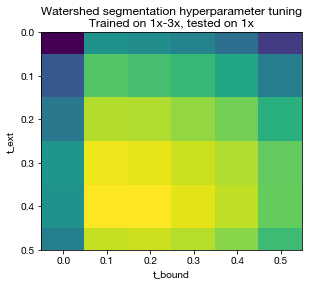

In [99]:
# trained on 1x-3x, tested on 1x
hp_df = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_original/watershed_hyperparameters.csv')

print("Best hyperparameters:")
print(hp_df.iloc[hp_df['mIoU'].idxmax()])

plt.imshow(hp_df['mIoU'].values.reshape((len(t_exts), len(t_bounds))))
plt.xticks(np.arange(len(t_bounds)), ['{:0.1f}'.format(x) for x in t_bounds])
plt.xlabel('t_bound')
plt.yticks(np.arange(len(t_exts)), ['{:0.1f}'.format(x) for x in t_exts])
plt.ylabel('t_ext')
plt.title('Watershed segmentation hyperparameter tuning\nTrained on 1x-3x, tested on 1x')
plt.show()

Best hyperparameters:
Unnamed: 0    26.000000
t_ext          0.400000
t_bound        0.200000
mIoU           0.863968
IoU_50         0.890667
Name: 26, dtype: float64


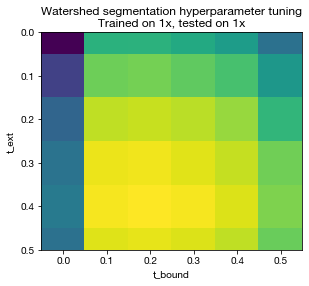

In [98]:
# trained on 1x, tested on 1x
hp_df = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_original-resolution_finetuned/Airbus_original/watershed_hyperparameters.csv')

print("Best hyperparameters:")
print(hp_df.iloc[hp_df['mIoU'].idxmax()])

plt.imshow(hp_df['mIoU'].values.reshape((len(t_exts), len(t_bounds))))
plt.xticks(np.arange(len(t_bounds)), ['{:0.1f}'.format(x) for x in t_bounds])
plt.xlabel('t_bound')
plt.yticks(np.arange(len(t_exts)), ['{:0.1f}'.format(x) for x in t_exts])
plt.ylabel('t_ext')
plt.title('Watershed segmentation hyperparameter tuning\nTrained on 1x, tested on 1x')
plt.show()

Best hyperparameters:
Unnamed: 0    26.000000
t_ext          0.400000
t_bound        0.200000
mIoU           0.851383
IoU_50         0.879288
Name: 26, dtype: float64


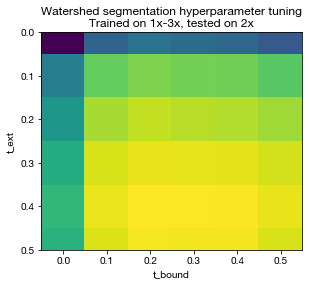

In [191]:
# trained on 1x-3x, tested on 2x
hp_df = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_2x_downsampled/watershed_hyperparameters.csv')

print("Best hyperparameters:")
print(hp_df.iloc[hp_df['mIoU'].idxmax()])

plt.imshow(hp_df['mIoU'].values.reshape((len(t_exts), len(t_bounds))))
plt.xticks(np.arange(len(t_bounds)), ['{:0.1f}'.format(x) for x in t_bounds])
plt.xlabel('t_bound')
plt.yticks(np.arange(len(t_exts)), ['{:0.1f}'.format(x) for x in t_exts])
plt.ylabel('t_ext')
plt.title('Watershed segmentation hyperparameter tuning\nTrained on 1x-3x, tested on 2x')
plt.show()

Best hyperparameters:
Unnamed: 0    27.000000
t_ext          0.400000
t_bound        0.300000
mIoU           0.844949
IoU_50         0.852243
Name: 27, dtype: float64


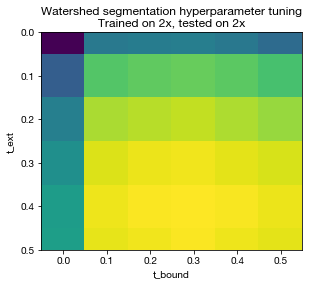

In [192]:
# trained on 2x, tested on 2x
hp_df = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_2x-downsampled-erosion1px_finetuned/Airbus_2x_downsampled/watershed_hyperparameters.csv')

print("Best hyperparameters:")
print(hp_df.iloc[hp_df['mIoU'].idxmax()])

plt.imshow(hp_df['mIoU'].values.reshape((len(t_exts), len(t_bounds))))
plt.xticks(np.arange(len(t_bounds)), ['{:0.1f}'.format(x) for x in t_bounds])
plt.xlabel('t_bound')
plt.yticks(np.arange(len(t_exts)), ['{:0.1f}'.format(x) for x in t_exts])
plt.ylabel('t_ext')
plt.title('Watershed segmentation hyperparameter tuning\nTrained on 2x, tested on 2x')
plt.show()

Best hyperparameters:
Unnamed: 0    33.000000
t_ext          0.500000
t_bound        0.300000
mIoU           0.809524
IoU_50         0.803479
Name: 33, dtype: float64


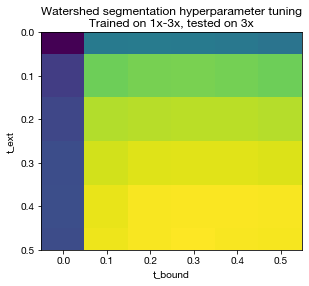

In [104]:
# trained on 1x-3x, tested on 3x
hp_df = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled/watershed_hyperparameters.csv')

print("Best hyperparameters:")
print(hp_df.iloc[hp_df['mIoU'].idxmax()])

plt.imshow(hp_df['mIoU'].values.reshape((len(t_exts), len(t_bounds))))
plt.xticks(np.arange(len(t_bounds)), ['{:0.1f}'.format(x) for x in t_bounds])
plt.xlabel('t_bound')
plt.yticks(np.arange(len(t_exts)), ['{:0.1f}'.format(x) for x in t_exts])
plt.ylabel('t_ext')
plt.title('Watershed segmentation hyperparameter tuning\nTrained on 1x-3x, tested on 3x')
plt.show()

Best hyperparameters:
t_ext      0.500000
t_bound    0.200000
mIoU       0.785551
IoU_50     0.777062
Name: 57, dtype: float64


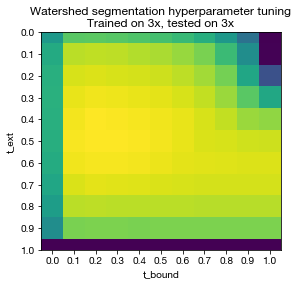

In [146]:
# trained on 3x, tested on 3x
hp_df = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled/watershed_hyperparameters.csv')

print("Best hyperparameters:")
print(hp_df.iloc[hp_df['mIoU'].idxmax()])

# fig, ax = plt.subplots(1, 1, figsize=(6, 6))
plt.imshow(hp_df['mIoU'].values.reshape((11, 11)))
plt.xticks(np.arange(11), ['{:0.1f}'.format(x) for x in np.linspace(0, 1, 11)])
plt.xlabel('t_bound')
plt.yticks(np.arange(11), ['{:0.1f}'.format(x) for x in np.linspace(0, 1, 11)])
plt.ylabel('t_ext')
plt.title('Watershed segmentation hyperparameter tuning\nTrained on 3x, tested on 3x')
plt.show()

Best hyperparameters:
t_ext      0.500000
t_bound    0.200000
mIoU       0.766145
IoU_50     0.735180
Name: 57, dtype: float64


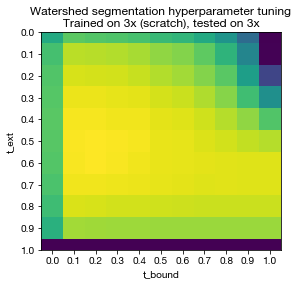

In [108]:
# trained on 3x from scratch, tested on 3x
hp_df = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_fromscratch/Airbus_3x_downsampled/watershed_hyperparameters.csv')

print("Best hyperparameters:")
print(hp_df.iloc[hp_df['mIoU'].idxmax()])

# fig, ax = plt.subplots(1, 1, figsize=(6, 6))
plt.imshow(hp_df['mIoU'].values.reshape((11, 11)))
plt.xticks(np.arange(11), ['{:0.1f}'.format(x) for x in np.linspace(0, 1, 11)])
plt.xlabel('t_bound')
plt.yticks(np.arange(11), ['{:0.1f}'.format(x) for x in np.linspace(0, 1, 11)])
plt.ylabel('t_ext')
plt.title('Watershed segmentation hyperparameter tuning\nTrained on 3x (scratch), tested on 3x')
plt.show()

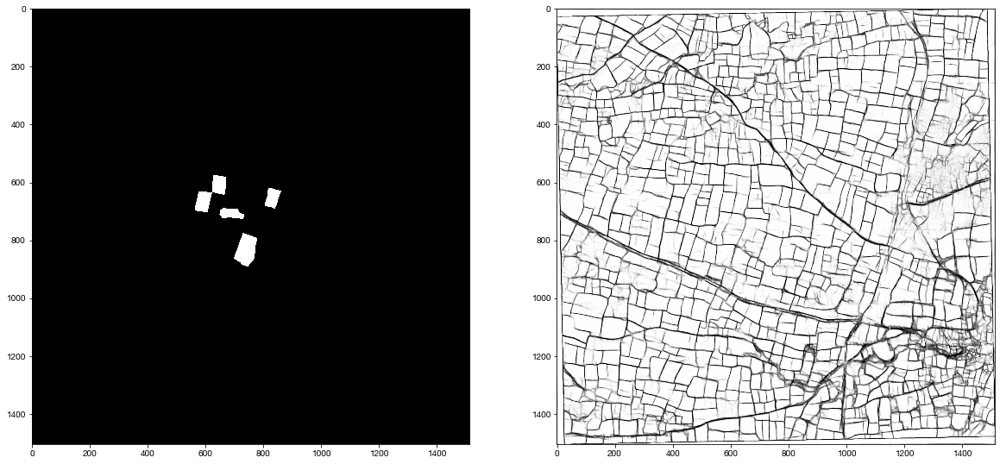

In [117]:
fig, ax = plt.subplots(1, 2, figsize=(20, 10))
image_id = '0001'
extent_truth = imageio.imread('../data/general_blockchain/airbus_labels/large/original/airbus_geowiki_C{}.png'.format(image_id))
extent_pred = imageio.imread('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_original/extent_full/airbus_geowiki_C{}.png'.format(image_id))
ax[0].imshow(extent_truth, cmap='Greys_r')
ax[1].imshow(extent_pred, cmap='Greys_r')
plt.show()

In [6]:
iou_df1 = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_original/val_IoUs.csv')

In [3]:
iou_df1 = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_original/val_IoUs.csv')
iou_df2 = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_2x_downsampled/val_IoUs.csv')
iou_df2_1x = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_2x_downsampled/val_IoUs_resized-to-1x.csv')
iou_df3 = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled/val_IoUs.csv')
iou_df3_1x = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled/val_IoUs_resized-to-1x.csv')

print("Trained on 1x-3x")
print("    Tested on 1x: mIoU = {:0.2f}, IoU50 = {:0.2f}".format(
    iou_df1['IoU'].median(), np.sum(np.array(iou_df1['IoU']) > 0.5) / len(iou_df1['IoU'])))
print("    Tested on 2x: mIoU = {:0.2f}, IoU50 = {:0.2f}".format(
    iou_df2['IoU'].median(), np.sum(np.array(iou_df2['IoU']) > 0.5) / len(iou_df2['IoU'])))
print("    Tested on 3x: mIoU = {:0.2f}, IoU50 = {:0.2f}".format(
    iou_df3['IoU'].median(), np.sum(np.array(iou_df3['IoU']) > 0.5) / len(iou_df3['IoU'])))
print("    Tested on 2x, resized to 1x: mIoU = {:0.2f}, IoU50 = {:0.2f}".format(
    iou_df2_1x['IoU'].median(), np.sum(np.array(iou_df2_1x['IoU']) > 0.5) / len(iou_df2_1x['IoU'])))
print("    Tested on 3x, resized to 1x: mIoU = {:0.2f}, IoU50 = {:0.2f}".format(
    iou_df3_1x['IoU'].median(), np.sum(np.array(iou_df3_1x['IoU']) > 0.5) / len(iou_df3_1x['IoU'])))

Trained on 1x-3x
    Tested on 1x: mIoU = 0.86, IoU50 = 0.90
    Tested on 2x: mIoU = 0.85, IoU50 = 0.88
    Tested on 3x: mIoU = 0.73, IoU50 = 0.77
    Tested on 2x, resized to 1x: mIoU = 0.80, IoU50 = 0.88
    Tested on 3x, resized to 1x: mIoU = 0.65, IoU50 = 0.73


In [18]:
watershed_df1 = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_original-resolution_finetuned/Airbus_original/watershed_hyperparameters.csv')
watershed_df2 = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_2x-downsampled-erosion1px_finetuned/Airbus_2x_downsampled/watershed_hyperparameters.csv')
watershed_df3 = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled/watershed_hyperparameters.csv')

print("Trained on 1x, tested on 1x: mIoU = {:0.2f}".format(watershed_df1['mIoU'].max()))
print("Trained on 2x, tested on 2x: mIoU = {:0.2f}".format(watershed_df2['mIoU'].max()))
print("Trained on 3x, tested on 3x: mIoU = {:0.2f}".format(watershed_df3['mIoU'].max()))

Trained on 1x, tested on 1x: mIoU = 0.86
Trained on 2x, tested on 2x: mIoU = 0.84
Trained on 3x, tested on 3x: mIoU = 0.79


In [ ]:
# OPTIMAL HYPERPARAMETERS - VAL PERFORMANCE
# =================================== #
# Trained on 1x-3x
# ----------------------------------- #
# Tested on 1x:
# t_ext = , t_bound = 
# mIoU = 0.86, IoU_50 = 0.90

# Tested on 2x:
# t_ext = 0.1, t_bound = 0.3
# mIoU = 0.81, IoU_50 = 0.76

# Tested on 3x:
# t_ext = 0.4, t_bound = 0.1
# mIoU = 0.798, IoU_50 = 0.813

# =================================== #

# Trained on 1x
# Tested on 1x:
# t_ext = , t_bound = 
# mIoU = , IoU_50 = 

# =================================== #

# Trained on 2x
# Tested on 2x:
# t_ext = 0.2, t_bound = 0.2
# mIoU = 0.81, IoU_50 = 0.74

# =================================== #

# Trained on 3x
# Tested on 3x:
# t_ext = , t_bound = 
# mIoU = , IoU_50 = 


In [ ]:
# OLD RESULTS (measuring recall, not IoU)

# Trained on 1x-3x
# Tested on 1x:
# t_ext = 0.1, t_bound = 0.2
# mIoU = 0.932622 IoU_50 = 0.865539

# Tested on 2x:
# t_ext = 0.0, t_bound = 0.5
# mIoU = 0.893237 IoU_50 = 0.758621

# Tested on 3x:
# t_ext = 0.2, t_bound = 0.2
# mIoU = 0.908745 IoU_50 = 0.893589

# =================================== #

# Trained on 1x
# Tested on 1x:
# t_ext = 0.1, t_bound = 0.3
# mIoU = 0.938788 IoU_50 = 0.881567

# =================================== #

# Trained on 2x
# Tested on 2x:
# t_ext = 0.0, t_bound = 0.5
# mIoU = 0.879046 IoU_50 = 0.759852

# =================================== #

# Trained on 3x
# Tested on 3x:



### Get validation set IoUs

In [193]:
t_ext = 0.4
t_bound = 0.1

# label_dir = '../data/general_blockchain/airbus_labels/large/3x_downsample_erosion2px_val/'
label_dir = '../data/general_blockchain/airbus_labels/large/2x_downsample_erosion1px/'
# label_dir = '../data/general_blockchain/airbus_labels/large/original/'

model_name = 'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned'
# model_name = 'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_2x-downsampled-erosion1px_finetuned/'
# model_name = 'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_original-resolution_finetuned/'

# results_dir = '../results/india/GeneralBlockchain/{}/Airbus_3x_downsampled/'.format(model_name)
results_dir = '../results/india/GeneralBlockchain/{}/Airbus_2x_downsampled/'.format(model_name)
# results_dir = '../results/india/GeneralBlockchain/{}/Airbus_original/'.format(model_name)

IoUs = []
field_sizes = []
field_image_ids = []

for i, image_id in enumerate(val_ids):
    if i % 100 == 0:
        print(i)
    label_path = os.path.join(label_dir, 'airbus_geowiki_C{}.png'.format(image_id))
#     if os.path.exists(label_path):
    example_truth = imageio.imread(label_path)
#     extent_pred = np.load(os.path.join(results_dir, 'extent_predictions/airbus_geowiki_C{}.npy'.format(image_id)))
#     boundary_pred = np.load(os.path.join(results_dir, 'boundary_predictions/airbus_geowiki_C{}.npy'.format(image_id)))                
    extent_pred = imageio.imread(os.path.join(results_dir, 'extent_full/airbus_geowiki_C{}.png'.format(image_id)))
    extent_pred = np.array(extent_pred, dtype=np.float32) / 255.
    boundary_pred = imageio.imread(os.path.join(results_dir, 'boundary_full/airbus_geowiki_C{}.png'.format(image_id)))
    boundary_pred = np.array(boundary_pred, dtype=np.float32) / 255.
    img_IoUs, img_field_sizes = get_IoUs(example_truth, extent_pred, boundary_pred, t_ext=t_ext, t_bound=t_bound)
    IoUs = IoUs + img_IoUs
    field_sizes = field_sizes + img_field_sizes
    field_image_ids = field_image_ids + ([image_id] * len(img_IoUs))

0
100
200


In [194]:
iou_df = pd.DataFrame({
    'image_id': field_image_ids,
    'IoU': IoUs,
    'field_size': field_sizes,
})
iou_df.to_csv(os.path.join(results_dir, 'val_IoUs.csv'), index=False)

### Field size vs. IoU

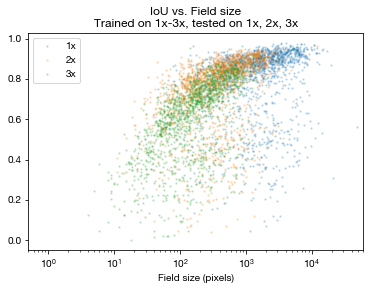

In [9]:
# field sizes (pixels)
# individual fields
iou_df1 = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_original/val_IoUs.csv')
# iou_df2 = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_2x_downsampled/val_IoUs.csv')
iou_df2 = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_2x_downsampled/val_IoUs_resized-to-1x.csv')
# iou_df3 = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled/val_IoUs.csv')
iou_df3 = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled/val_IoUs_resized-to-1x.csv')

plt.scatter(iou_df1['field_size'], iou_df1['IoU'], alpha=0.2, s=2)
plt.scatter(iou_df2['field_size'] // 4, iou_df2['IoU'], alpha=0.2, s=2)
plt.scatter(iou_df3['field_size'] // 9, iou_df3['IoU'], alpha=0.2, s=2)
plt.xscale('log')
plt.title('IoU vs. Field size\nTrained on 1x-3x, tested on 1x, 2x, 3x')
plt.legend(['1x', '2x', '3x'])
plt.xlabel('Field size (pixels)')
plt.xlim([0.5, 6e4])
plt.show()

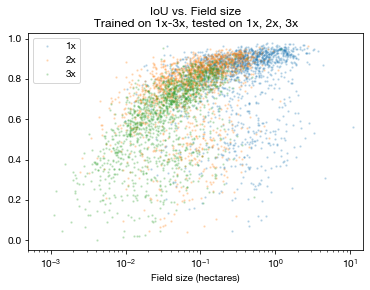

In [20]:
# field sizes (hectares)
# individual fields
iou_df1 = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_original/val_IoUs.csv')
# iou_df2 = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_2x_downsampled/val_IoUs.csv')
iou_df2 = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_2x_downsampled/val_IoUs_resized-to-1x.csv')
# iou_df3 = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled/val_IoUs.csv')
iou_df3 = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled/val_IoUs_resized-to-1x.csv')

conversion_factor = 1.5**2 / 10000.

plt.scatter(iou_df1['field_size'] * conversion_factor, iou_df1['IoU'], alpha=0.2, s=2)
plt.scatter(iou_df2['field_size'] / 4 * conversion_factor, iou_df2['IoU'], alpha=0.2, s=2)
plt.scatter(iou_df3['field_size'] / 9 * conversion_factor, iou_df3['IoU'], alpha=0.2, s=2)
plt.xscale('log')
plt.title('IoU vs. Field size\nTrained on 1x-3x, tested on 1x, 2x, 3x')
plt.legend(['1x', '2x', '3x'])
plt.xlabel('Field size (hectares)')
plt.xlim([0.0005, 15])
plt.show()

In [31]:
iou_df1[(iou_df1['field_size'] > 500) & (iou_df1['IoU'] <= 0.5)].head(n=50)

,image_id,IoU,field_size
17,8,0.370525,4502
112,138,0.315934,1673
113,138,0.475343,1754
121,151,0.423034,886
133,161,0.399218,6369
157,172,0.414435,3506
160,173,0.364939,907
182,184,0.449620,5352
183,184,0.495374,5978
231,256,0.496038,2512


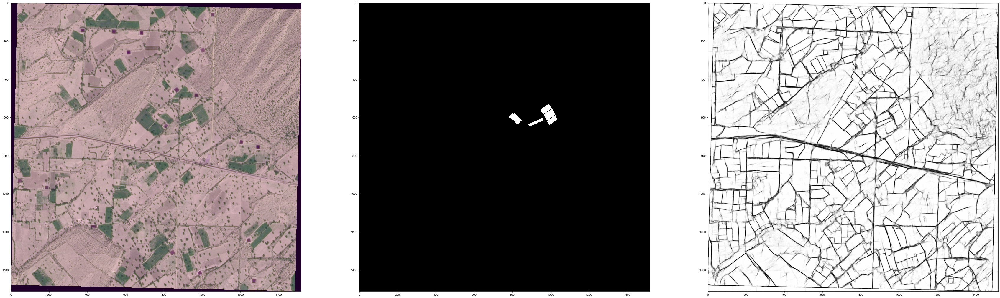

In [35]:
fig, ax = plt.subplots(1, 3, figsize=(60, 20))
image_id = str(638).zfill(4)
img = imageio.imread('../data/general_blockchain/airbus_false_color/large/original/airbus_geowiki_C{}.png'.format(image_id))
label = imageio.imread('../data/general_blockchain/airbus_labels/large/original/airbus_geowiki_C{}.png'.format(image_id))
prediction = imageio.imread('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_original/extent_full/airbus_geowiki_C{}.png'.format(image_id))
ax[0].imshow(img)
ax[1].imshow(label, cmap='Greys_r')
ax[2].imshow(prediction, cmap='Greys_r')
plt.show()


### Which fields is it better to have lower resolution imagery?

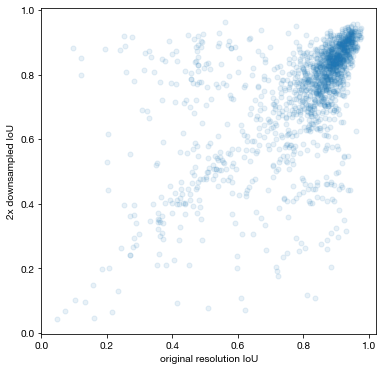

In [4]:
fig, ax = plt.subplots(1, 1, figsize=(6,6))
plt.plot(iou_df1['IoU'], iou_df2_1x['IoU'], 'o', ms=5, alpha=0.1)
plt.xlabel('original resolution IoU')
plt.ylabel('2x downsampled IoU')
plt.show()

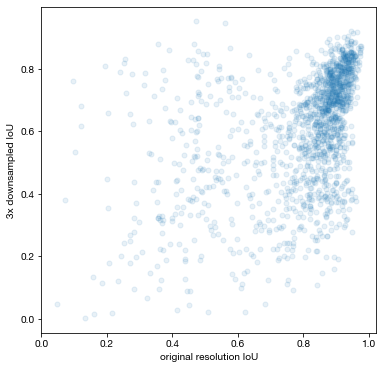

In [5]:
fig, ax = plt.subplots(1, 1, figsize=(6,6))
plt.plot(iou_df1['IoU'], iou_df3_1x['IoU'], 'o', ms=5, alpha=0.1)
plt.xlabel('original resolution IoU')
plt.ylabel('3x downsampled IoU')
plt.show()

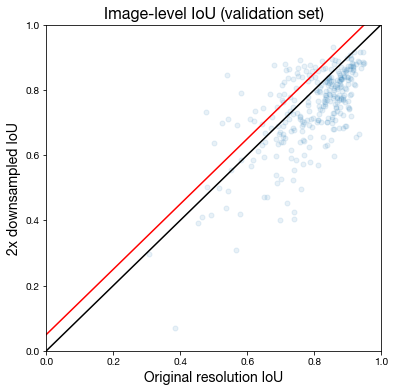

In [74]:
iou_df1_image = iou_df1.groupby(['image_id']).mean().reset_index()
iou_df2_1x_image = iou_df2_1x.groupby(['image_id']).mean().reset_index()

fs = 14

fig, ax = plt.subplots(1, 1, figsize=(6,6))
plt.plot(iou_df1_image['IoU'], iou_df2_1x_image['IoU'], 'o', ms=5, alpha=0.1)
plt.plot([0, 2], [0, 2], '-', color='k')
plt.plot([0, 2], [0.05, 2.05], '-', color='red')
plt.xlabel('Original resolution IoU', fontsize=fs)
plt.ylabel('2x downsampled IoU', fontsize=fs)
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title('Image-level IoU (validation set)', fontsize=fs+2)
plt.show()

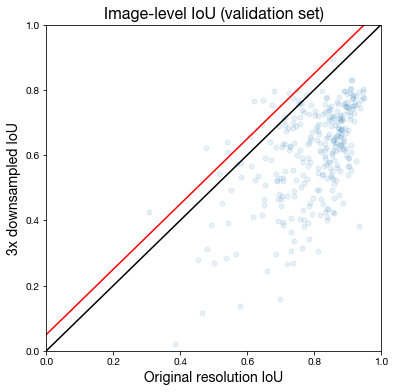

In [76]:
iou_df1_image = iou_df1.groupby(['image_id']).mean().reset_index()
iou_df3_1x_image = iou_df3_1x.groupby(['image_id']).mean().reset_index()

fs = 14

fig, ax = plt.subplots(1, 1, figsize=(6,6))
plt.plot(iou_df1_image['IoU'], iou_df3_1x_image['IoU'], 'o', ms=5, alpha=0.1)
plt.plot([0, 2], [0, 2], '-', color='k')
plt.plot([0, 2], [0.05, 2.05], '-', color='red')
plt.xlabel('Original resolution IoU', fontsize=fs)
plt.ylabel('3x downsampled IoU', fontsize=fs)
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title('Image-level IoU (validation set)', fontsize=fs+2)
plt.show()

In [82]:
splits_df[splits_df['image_id'] == '0638']

,image_id,lat,lon,fold
877,0638,27.992597,72.228585,val


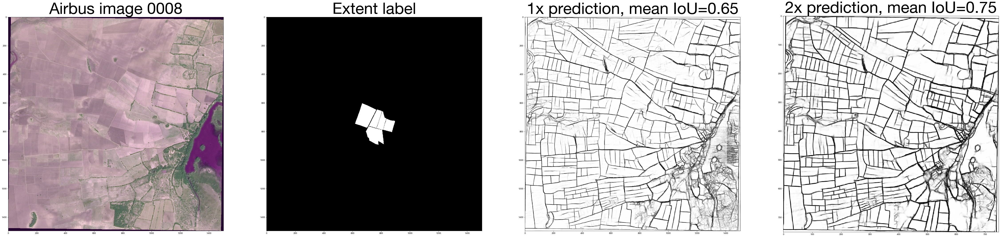

In [95]:
fs = 72

merged = iou_df1_image.merge(iou_df2_1x_image[['image_id', 'IoU']], on='image_id', how='inner')
df_2xbetter = merged[merged['IoU_y'] > merged['IoU_x'] + 0.05]

for i, row in df_2xbetter.iterrows():
    
    fig, ax = plt.subplots(1, 4, figsize=(80, 20))
    image_id = str(int(row['image_id'])).zfill(4)
    img = imageio.imread('../data/general_blockchain/airbus_false_color/large/original/airbus_geowiki_C{}.png'.format(image_id))
    label = imageio.imread('../data/general_blockchain/airbus_labels/large/original/airbus_geowiki_C{}.png'.format(image_id))
    prediction1x = imageio.imread('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_original/extent_full/airbus_geowiki_C{}.png'.format(image_id))
    prediction2x = imageio.imread('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_2x_downsampled/extent_full/airbus_geowiki_C{}.png'.format(image_id))
    ax[0].imshow(img)
    ax[0].set_title('Airbus image {}'.format(image_id), fontsize=fs)
    ax[1].imshow(label, cmap='Greys_r')
    ax[1].set_title('Extent label', fontsize=fs)
    ax[2].imshow(prediction1x, cmap='Greys_r')
    ax[2].set_title('1x prediction, mean IoU={:0.2f}'.format(row['IoU_x']), fontsize=fs)
    ax[3].imshow(prediction2x, cmap='Greys_r')
    ax[3].set_title('2x prediction, mean IoU={:0.2f}'.format(row['IoU_y']), fontsize=fs)
    plt.show()
    break

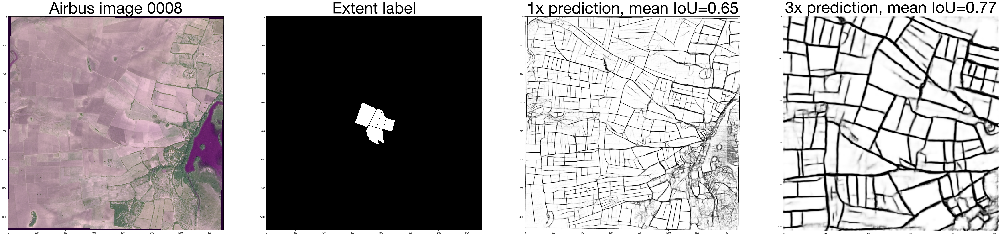

In [93]:
fs = 72

merged = iou_df1_image.merge(iou_df3_1x_image[['image_id', 'IoU']], on='image_id', how='inner')
df_3xbetter = merged[merged['IoU_y'] > merged['IoU_x'] + 0.05]

for i, row in df_3xbetter.iterrows():
    
    fig, ax = plt.subplots(1, 4, figsize=(80, 20))
    image_id = str(int(row['image_id'])).zfill(4)
    img = imageio.imread('../data/general_blockchain/airbus_false_color/large/original/airbus_geowiki_C{}.png'.format(image_id))
    label = imageio.imread('../data/general_blockchain/airbus_labels/large/original/airbus_geowiki_C{}.png'.format(image_id))
    prediction1x = imageio.imread('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_original/extent_full/airbus_geowiki_C{}.png'.format(image_id))
    prediction3x = np.load('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled/extent_predictions/airbus_geowiki_C{}.npy'.format(image_id))
    ax[0].imshow(img)
    ax[0].set_title('Airbus image {}'.format(image_id), fontsize=fs)
    ax[1].imshow(label, cmap='Greys_r')
    ax[1].set_title('Extent label', fontsize=fs)
    ax[2].imshow(prediction1x, cmap='Greys_r')
    ax[2].set_title('1x prediction, mean IoU={:0.2f}'.format(row['IoU_x']), fontsize=fs)
    ax[3].imshow(prediction3x, cmap='Greys_r')
    ax[3].set_title('3x prediction, mean IoU={:0.2f}'.format(row['IoU_y']), fontsize=fs)
    plt.show()
    break

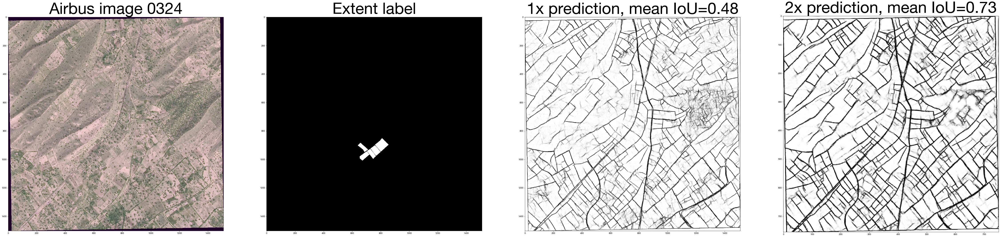

In [94]:
merged = iou_df1_image.merge(iou_df2_1x_image[['image_id', 'IoU']], on='image_id', how='inner')
subset_df = splits_df[(splits_df['lon'] > 70) & (splits_df['lon'] < 72) &
                      (splits_df['lat'] > 24) & (splits_df['lat'] < 26) & (splits_df['fold'] == 'val')]
dry_areas = merged[merged['image_id'].isin(subset_df['image_id'])]

fs = 72

for i, row in dry_areas.iterrows():
    
    fig, ax = plt.subplots(1, 4, figsize=(80, 20))
    image_id = str(int(row['image_id'])).zfill(4)
    img = imageio.imread('../data/general_blockchain/airbus_false_color/large/original/airbus_geowiki_C{}.png'.format(image_id))
    label = imageio.imread('../data/general_blockchain/airbus_labels/large/original/airbus_geowiki_C{}.png'.format(image_id))
    prediction1x = imageio.imread('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_original/extent_full/airbus_geowiki_C{}.png'.format(image_id))
    prediction2x = imageio.imread('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_2x_downsampled/extent_full/airbus_geowiki_C{}.png'.format(image_id))
    ax[0].imshow(img)
    ax[0].set_title('Airbus image {}'.format(image_id), fontsize=fs)
    ax[1].imshow(label, cmap='Greys_r')
    ax[1].set_title('Extent label', fontsize=fs)
    ax[2].imshow(prediction1x, cmap='Greys_r')
    ax[2].set_title('1x prediction, mean IoU={:0.2f}'.format(row['IoU_x']), fontsize=fs)
    ax[3].imshow(prediction2x, cmap='Greys_r')
    ax[3].set_title('2x prediction, mean IoU={:0.2f}'.format(row['IoU_y']), fontsize=fs)
    plt.show()
    break

#### On a map

##### Original resolution performance

In [25]:
bbox_df = pd.read_csv('../data/general_blockchain/bbox_india_GB_large_Airbus.csv')
grouped = iou_df1.groupby('image_id').mean().reset_index().merge(bbox_df, on=['image_id'], how='left')

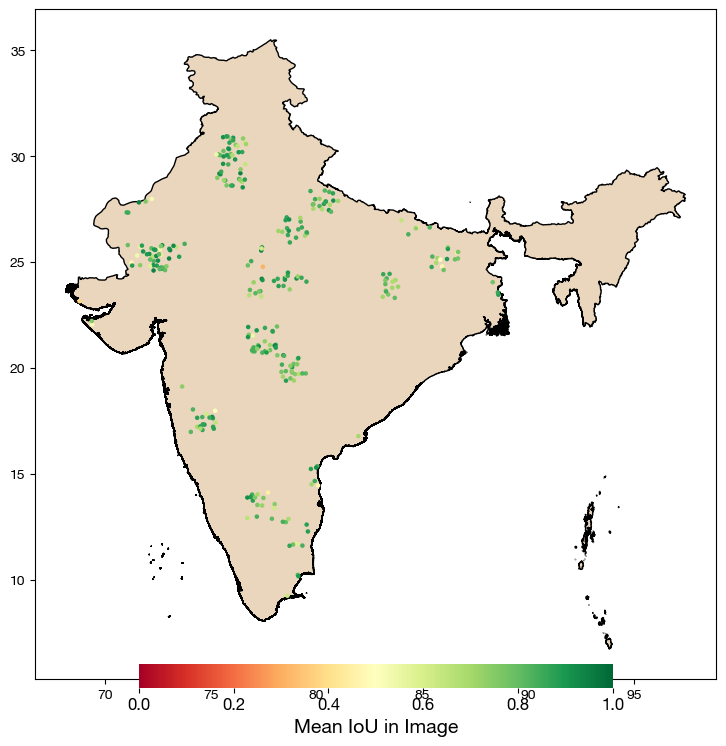

In [84]:
# map of India
india = gpd.read_file('../mount/data/gadm36_IND_shp/gadm36_IND_0.shp')

fs = 14
# min_lon = 68
# min_lat = 9
# max_lon = 97
# max_lat = 35
# delta_lon = max_lon - min_lon
# delta_lat = max_lat - min_lat
# n_grid_side = 20
# splits_dict = {0: 'train', 1: 'val', 2: 'test'}
# split_grid_india = np.load('../data/splits/india_grid_20x20.npy')
# train_alpha = 0.2
# test_alpha = 0

# boxes_india = []
# box_alphas = []
# for i, row in enumerate(split_grid_india):
#     for j, grid_cell in enumerate(row):
#         min_y = min_lat + i * delta_lat / n_grid_side
#         max_y = min_lat + (i+1) * delta_lat / n_grid_side
#         min_x = min_lon + j * delta_lon / n_grid_side
#         max_x = min_lon + (j+1) * delta_lon / n_grid_side
        
#         boxes_india.append(box(min_x, min_y, max_x, max_y))
#         if grid_cell < 2:
#             box_alphas.append(train_alpha)
#         else:
#             box_alphas.append(test_alpha)

fig, ax = plt.subplots(1, figsize=(10.2,10.2), dpi=100)
india.plot(ax=ax, edgecolor='black', color='#e9d6bc')
im = plt.scatter(grouped['min_lon'], grouped['min_lat'], c=grouped['IoU'], vmin=0.0, vmax=1.0, s=5, cmap='RdYlGn')
# plt.title('(a) Geographic Distribution of IoUs', fontsize=fs+2)

# for i in range(len(boxes_india)):
#     if boxes_india[i].intersects(india['geometry'].values[0]):
#         ax.plot(*boxes_india[i].exterior.xy, color='k', alpha=train_alpha, linewidth=1)
#         ax.fill(*boxes_india[i].exterior.xy, fc='k', alpha=box_alphas[i], ec='none')

# colorbar
cb = fig.colorbar(im, orientation='horizontal', shrink=0.6, pad=-0.02)
cb.set_label(label='Mean IoU in Image', size=14)
cb.outline.set_visible(False)
cb.ax.tick_params(labelsize=12)

# plt.axis('off')
plt.show()

In [87]:
grouped2[grouped2['image_id'] == 1992]

,image_id,IoU_x,IoU_y,field_size,min_lat,min_lon,max_lat,max_lon,IoU_1xminus2x
295,1992,0.438396,0.535408,1556.0,25.3244,71.534735,25.3444,71.556863,0.097012


##### Original resolution minus 2x downsampled resolution

In [40]:
# bbox_df = pd.read_csv('../data/general_blockchain/bbox_india_GB_large_Airbus.csv')
# grouped = iou_df1.groupby('image_id').mean().reset_index().merge(bbox_df, on=['image_id'], how='left')
grouped2 = iou_df2_1x[['image_id', 'IoU']].groupby('image_id').mean().reset_index().merge(grouped, on=['image_id'], how='left')
grouped2['IoU_1xminus2x'] = grouped2['IoU_y'] - grouped2['IoU_x']
grouped2.head()

,image_id,IoU_x,IoU_y,field_size,min_lat,min_lon,max_lat,max_lon,IoU_1xminus2x
0,1,0.865069,0.914878,3428.6,25.707699,77.426401,25.727699,77.448599,0.049809
1,3,0.744734,0.905270,618.0,27.466000,80.584531,27.486000,80.607074,0.160536
2,4,0.852348,0.875149,2949.4,21.107701,78.076782,21.127701,78.098221,0.022801
3,8,0.745323,0.647078,8156.4,25.724400,73.376396,25.744400,73.398598,-0.098245
4,16,0.857286,0.870068,4655.8,24.266022,78.509863,24.286022,78.531803,0.012782


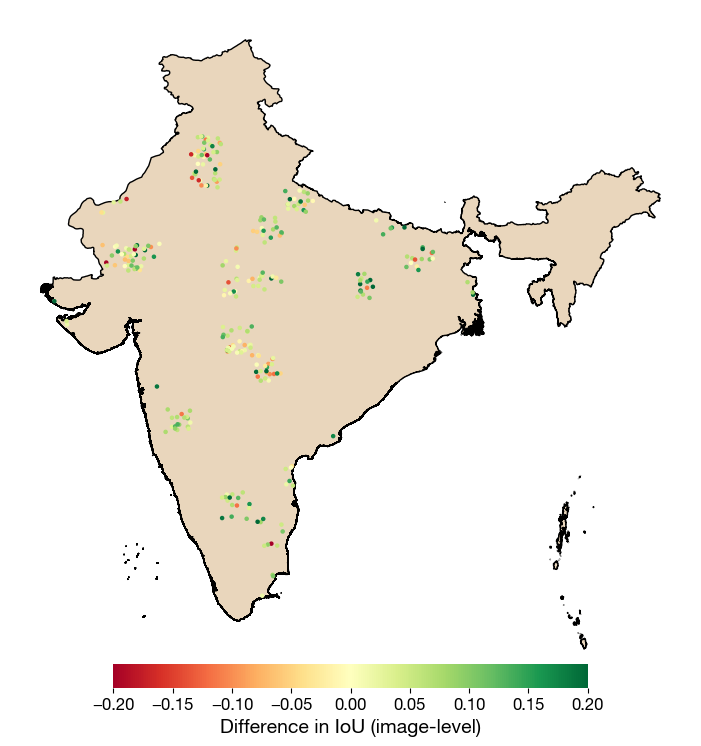

In [79]:
# map of India
india = gpd.read_file('../mount/data/gadm36_IND_shp/gadm36_IND_0.shp')

fs = 14
# min_lon = 68
# min_lat = 9
# max_lon = 97
# max_lat = 35
# delta_lon = max_lon - min_lon
# delta_lat = max_lat - min_lat
# n_grid_side = 20
# splits_dict = {0: 'train', 1: 'val', 2: 'test'}
# split_grid_india = np.load('../data/splits/india_grid_20x20.npy')
# train_alpha = 0.2
# test_alpha = 0

# boxes_india = []
# box_alphas = []
# for i, row in enumerate(split_grid_india):
#     for j, grid_cell in enumerate(row):
#         min_y = min_lat + i * delta_lat / n_grid_side
#         max_y = min_lat + (i+1) * delta_lat / n_grid_side
#         min_x = min_lon + j * delta_lon / n_grid_side
#         max_x = min_lon + (j+1) * delta_lon / n_grid_side
        
#         boxes_india.append(box(min_x, min_y, max_x, max_y))
#         if grid_cell < 2:
#             box_alphas.append(train_alpha)
#         else:
#             box_alphas.append(test_alpha)

fig, ax = plt.subplots(1, figsize=(10.2,10.2), dpi=100)
india.plot(ax=ax, edgecolor='black', color='#e9d6bc')
im = plt.scatter(grouped2['min_lon'], grouped2['min_lat'], c=grouped2['IoU_1xminus2x'], vmin=-0.2, vmax=0.2, s=5, cmap='RdYlGn')
# plt.title('(a) Geographic Distribution of IoUs', fontsize=fs+2)

# for i in range(len(boxes_india)):
#     if boxes_india[i].intersects(india['geometry'].values[0]):
#         ax.plot(*boxes_india[i].exterior.xy, color='k', alpha=train_alpha, linewidth=1)
#         ax.fill(*boxes_india[i].exterior.xy, fc='k', alpha=box_alphas[i], ec='none')

# colorbar
cb = fig.colorbar(im, orientation='horizontal', shrink=0.6, pad=-0.02)
cb.set_label(label='Difference in IoU (image-level)', size=14)
cb.outline.set_visible(False)
cb.ax.tick_params(labelsize=12)

plt.axis('off')
plt.show()

#### Scale 2x back up to 1x

In [4]:
import cv2

In [5]:
label_dir = '../data/general_blockchain/airbus_labels/large/original/'
model_name = 'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned'
results_dir = '../results/india/GeneralBlockchain/{}/Airbus_2x_downsampled/'.format(model_name)

if not os.path.exists(os.path.join(results_dir, 'extent_full_1x')):
    os.makedirs(os.path.join(results_dir, 'extent_full_1x'))
    os.makedirs(os.path.join(results_dir, 'boundary_full_1x'))

for i, image_id in enumerate(val_ids):
    if i % 100 == 0:
        print(i)
    label_path = os.path.join(label_dir, 'airbus_geowiki_C{}.png'.format(image_id))

    example_truth = imageio.imread(label_path)
    extent_pred = imageio.imread(os.path.join(results_dir, 'extent_full/airbus_geowiki_C{}.png'.format(image_id)))
    boundary_pred = imageio.imread(os.path.join(results_dir, 'boundary_full/airbus_geowiki_C{}.png'.format(image_id)))                
    
    height, width = example_truth.shape
    reshape_shape = (width, height)
    extent_pred_1x = cv2.resize(extent_pred, reshape_shape, interpolation = cv2.INTER_LINEAR)
    boundary_pred_1x = cv2.resize(boundary_pred, reshape_shape, interpolation = cv2.INTER_LINEAR)
    
    imageio.imwrite(os.path.join(results_dir, 'extent_full_1x/airbus_geowiki_C{}.png').format(image_id), extent_pred_1x)
    imageio.imwrite(os.path.join(results_dir, 'boundary_full_1x/airbus_geowiki_C{}.png').format(image_id), boundary_pred_1x)

0
100
200


In [6]:
t_ext = 0.4
t_bound = 0.2

label_dir = '../data/general_blockchain/airbus_labels/large/original/'
model_name = 'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned'
results_dir = '../results/india/GeneralBlockchain/{}/Airbus_2x_downsampled/'.format(model_name)

IoUs = []
field_sizes = []
field_image_ids = []

for i, image_id in enumerate(val_ids):
    if i % 100 == 0:
        print(i)
    label_path = os.path.join(label_dir, 'airbus_geowiki_C{}.png'.format(image_id))

    example_truth = imageio.imread(label_path)
    extent_pred = imageio.imread(os.path.join(results_dir, 'extent_full_1x/airbus_geowiki_C{}.png'.format(image_id)))
    extent_pred = np.array(extent_pred, dtype=np.float32) / 255.
    boundary_pred = imageio.imread(os.path.join(results_dir, 'boundary_full_1x/airbus_geowiki_C{}.png'.format(image_id)))                
    boundary_pred = np.array(boundary_pred, dtype=np.float32) / 255.
    
    img_IoUs, img_field_sizes = get_IoUs(example_truth, extent_pred, boundary_pred, t_ext=t_ext, t_bound=t_bound)
    IoUs = IoUs + img_IoUs
    field_sizes = field_sizes + img_field_sizes
    field_image_ids = field_image_ids + ([image_id] * len(img_IoUs))

0
100
200


In [7]:
iou_df = pd.DataFrame({
    'image_id': field_image_ids,
    'IoU': IoUs,
    'field_size': field_sizes,
})
iou_df.to_csv(os.path.join(results_dir, 'val_IoUs_resized-to-1x.csv'), index=False)

#### Scale 3x back up to 1x

In [ ]:
t_ext = 0.5
t_bound = 0.2

label_dir = '../data/general_blockchain/airbus_labels/large/original/'
model_name = 'fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned'
results_dir = '../results/india/GeneralBlockchain/{}/Airbus_3x_downsampled/'.format(model_name)

IoUs = []
field_sizes = []
field_image_ids = []
n = 3

for i, image_id in enumerate(val_ids):
    if i % 100 == 0:
        print(i)
    label_path = os.path.join(label_dir, 'airbus_geowiki_C{}.png'.format(image_id))

    example_truth = imageio.imread(label_path)
    extent_crop = np.load(os.path.join(results_dir, 'extent_predictions/airbus_geowiki_C{}.npy'.format(image_id)))
    boundary_crop = np.load(os.path.join(results_dir, 'boundary_predictions/airbus_geowiki_C{}.npy'.format(image_id)))                
    extent_pred = np.zeros(example_truth.shape, dtype=np.float64)
    boundary_pred = np.zeros(example_truth.shape, dtype=np.float64)
    extent_crop = np.kron(extent_crop, np.ones((n,n)))
    boundary_crop = np.kron(boundary_crop, np.ones((n,n)))
    x_center, y_center = extent_pred.shape[0] // 2, extent_pred.shape[1] // 2
    x_crop_center, y_crop_center = extent_crop.shape[0] // 2, extent_crop.shape[1] // 2
    extent_pred[x_center-x_crop_center:x_center-x_crop_center+extent_crop.shape[0],
                y_center-y_crop_center:y_center-y_crop_center+extent_crop.shape[1]] = extent_crop
    boundary_pred[x_center-x_crop_center:x_center-x_crop_center+boundary_crop.shape[0],
                  y_center-y_crop_center:y_center-y_crop_center+boundary_crop.shape[1]] = boundary_crop
    
    img_IoUs, img_field_sizes = get_IoUs(example_truth, extent_pred, boundary_pred, t_ext=t_ext, t_bound=t_bound)
    IoUs = IoUs + img_IoUs
    field_sizes = field_sizes + img_field_sizes
    field_image_ids = field_image_ids + ([image_id] * len(img_IoUs))

In [161]:
label_1x = imageio.imread('../data/general_blockchain/airbus_labels/large/original/airbus_geowiki_C0004.png')
label_1x.shape

(1562, 1571)

In [183]:
label_2x = imageio.imread('../data/general_blockchain/airbus_labels/large/2x_downsample_erosion1px/airbus_geowiki_C0004.png')
label_2x.shape

(785, 781)

In [168]:
iou_df3.groupby(['image_id']).size().sort_values()

image_id
163      3
380      4
1        5
1253     5
1251     5
        ..
1184     7
797      8
695      8
1102     8
504     19
Length: 300, dtype: int64

In [173]:
label_3x = imageio.imread('../data/general_blockchain/airbus_labels/large/3x_downsample_erosion2px/airbus_geowiki_C0504.png')
label_3x.shape

(503, 501)

In [153]:
example_extent = imageio.imread('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_2x_downsampled/extent_full/airbus_geowiki_C1370.png')
example_extent.shape

(758, 754)

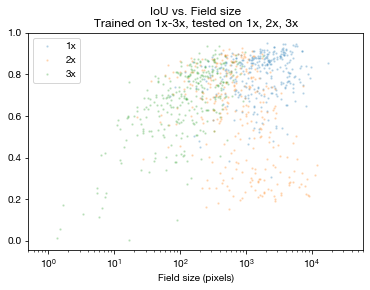

In [176]:
# field sizes
# image average
iou_df1 = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_original/val_IoUs.csv')
iou_df2 = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_2x_downsampled/val_IoUs.csv')
iou_df3 = pd.read_csv('../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_3x_downsampled/val_IoUs.csv')

iou_df1_grouped = iou_df1.groupby('image_id').mean()
iou_df2_grouped = iou_df2.groupby('image_id').mean()
iou_df3_grouped = iou_df3.groupby('image_id').mean()
plt.scatter(iou_df1_grouped['field_size'], iou_df1_grouped['IoU'], alpha=0.2, s=2)
plt.scatter(iou_df2_grouped['field_size'], iou_df2_grouped['IoU'], alpha=0.2, s=2)
plt.scatter(iou_df3_grouped['field_size'], iou_df3_grouped['IoU'], alpha=0.2, s=2)
plt.xscale('log')
plt.title('IoU vs. Field size\nTrained on 1x-3x, tested on 1x, 2x, 3x')
plt.legend(['1x', '2x', '3x'])
plt.xlabel('Field size (pixels)')
plt.xlim([0.5, 6e4])
plt.show()

In [151]:
iou_df2.groupby(['image_id']).size()

image_id
1       5
3       5
4       2
8       2
16      2
       ..
1992    1
1996    5
1997    4
1998    2
2000    5
Length: 300, dtype: int64

In [145]:
iou_df3.shape

(1552, 3)

In [148]:
iou_df2.shape

(965, 3)

ValueError: x and y must be the same size

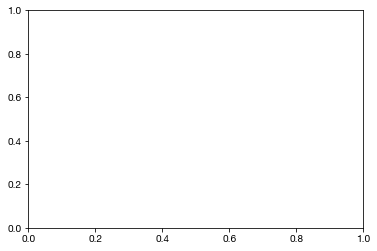

In [147]:
plt.scatter(iou_df1['IoU'], iou_df2['IoU'], alpha=0.2, s=2)
# plt.scatter(iou_df2['field_size'], iou_df2['IoU'], alpha=0.2, s=2)
# plt.scatter(iou_df3['field_size'], iou_df3['IoU'], alpha=0.2, s=2)
plt.title('IoU vs. Field size\nTrained on 1x-3x, tested on 1x, 2x, 3x')
# plt.legend(['1x', '2x', '3x'])
plt.show()

### Save instance predictions with best hyperparameters

In [71]:
t_ext = 0.0
t_bound = 0.5

results_dir = '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_1x-3x-downsampled-erosion2px_finetuned/Airbus_2x_downsampled/'
# results_dir = '../results/india/GeneralBlockchain/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_2x-downsampled-erosion1px_finetuned/Airbus_2x_downsampled/'
instances_dir = os.path.join(results_dir, 'instances_full')

if not os.path.exists(instances_dir):
    os.makedirs(instances_dir)

for i, image_id in enumerate(val_ids):
    if i % 10 == 0:
        print(i)

#     extent = np.load(os.path.join(results_dir, 'extent_predictions/airbus_geowiki_C{}.npy'.format(image_id)))
#     boundary = np.load(os.path.join(results_dir, 'boundary_predictions/airbus_geowiki_C{}.npy'.format(image_id)))
    extent = imageio.imread(os.path.join(results_dir, 'extent_full/airbus_geowiki_C{}.png'.format(image_id)))
    extent = np.array(extent, dtype=np.float32) / 255.
    boundary = imageio.imread(os.path.join(results_dir, 'boundary_full/airbus_geowiki_C{}.png'.format(image_id)))
    boundary = np.array(boundary, dtype=np.float32) / 255.

    instances = InstSegm(extent, boundary, t_ext=t_ext, t_bound=t_bound)

    # map instances to better range for plotting
    unique_instances = sorted(np.unique(instances))
    min_instance = unique_instances[1]
    max_instance = unique_instances[-1]
    n_instances = len(unique_instances)
    instance_map = {x: i for i, x in enumerate(unique_instances)}
    def map_values(x):
        return instance_map[x]
    instances_mapped = np.array(list(map(map_values, instances.flatten()))).reshape( 
        instances.shape[0], instances.shape[1])
    
    np.save(os.path.join(instances_dir, 'airbus_geowiki_C{}.npy'.format(image_id)), instances_mapped)

0
10
20
30
40
50
60
70
80
90
100
110
120
130
140
150
160
170
180
190
200
210
220
230
240
250
260
270
280
290


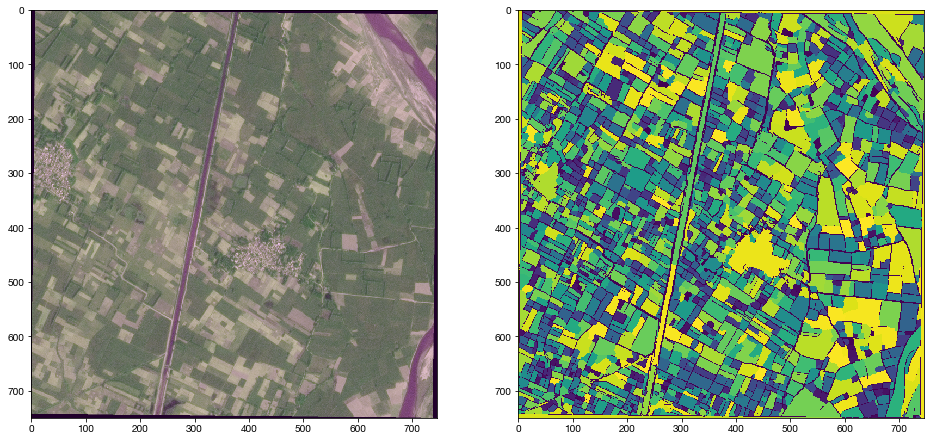

In [20]:
fig, ax = plt.subplots(1, 2, figsize=(16, 8))
unique_instances = sorted(np.unique(instances))
min_instance = unique_instances[1]
max_instance = unique_instances[-1]
n_instances = len(unique_instances)
instance_map = {x: i for i, x in enumerate(unique_instances)}
def map_values(x):
    return instance_map[x]
instances_mapped = np.array(list(map(map_values, instances.flatten()))).reshape( 
    instances.shape[0], instances.shape[1])

ax[0].imshow(img)
ax[1].imshow(instances_mapped)
plt.show()